In [156]:
from mtgsdk import Card
from mtgsdk import Set
from mtgsdk import Type
from mtgsdk import Supertype
from mtgsdk import Subtype
from mtgsdk import Changelog
import os
import nltk
import regex as re
from nltk.tokenize import word_tokenize
import pickle
import math
from scipy import spatial
import numpy as np
import requests
import json
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import RegexpTokenizer
from scipy import spatial
import sklearn 
from matplotlib import pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from sklearn.cluster import KMeans
import networkx as nx
from sklearn.decomposition import PCA
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import pandas as pd
import numpy as np
from datetime import datetime

import umap.umap_ as umap
import hdbscan
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from keras.layers import Dense, Input
from keras.models import Model
from keras.models import load_model
from keras.callbacks import ModelCheckpoint
import keras
import sys

In [157]:
all_data = json.load(open('cards_object.json'))
list_card_text = []
list_name_in_text = []

In [158]:
dict_flavor = {}
dict_text = {}
count = 0
stop_words = set(stopwords.words('english'))
stemmer = WordNetLemmatizer()
#tokenizer = RegexpTokenizer(r'\w+')
tokenizer = RegexpTokenizer(r'[\w\']+')
rarity_list = ['Mythic','Rare','Uncommon','Common']

for count,key in enumerate(all_data):
    if(type(all_data[key]['rarity']) == str and all_data[key]['rarity'] in rarity_list):
        modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['type'])
        tokenized = tokenizer.tokenize(modified_string)
        for each in tokenized:
            if(each != "—"):
                flavor_list = all_data[key]['flavor']
                try:
                    modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['text'])
                except:
                    modified_string = ''
                text_list = modified_string
                if(flavor_list == None):
                    flavor_list = ' '
                if(text_list == None):
                    text_list = ' '
                flavor_list = tokenizer.tokenize(flavor_list)
                text_list = tokenizer.tokenize(text_list)
                flavor_list = [w.lower() for w in flavor_list if not w.lower() in stop_words]
                text_list = [w.lower() for w in text_list if not w.lower() in stop_words]
                flavor_list = [stemmer.lemmatize(word) for word in flavor_list]
                text_list = [stemmer.lemmatize(word) for word in text_list]
                print(flavor_list)
                print(text_list)
                try:
                    if(flavor_list!= []):
                        dict_flavor[each].append(flavor_list)
                except:
                    if(flavor_list!= []):
                        dict_flavor[each] = []
                        dict_flavor[each].append(flavor_list)
                try:
                    if(text_list != []):
                        dict_text[each].append(text_list)
                except:
                    if(text_list != []):
                        dict_text[each] = []
                        dict_text[each].append(text_list)                    

    
    

['hand', 'done']
['first', 'strike', "ancestor's", 'chosen', 'enters', 'battlefield', 'gain', '1', 'life', 'card', 'graveyard']
['hand', 'done']
['first', 'strike', "ancestor's", 'chosen', 'enters', 'battlefield', 'gain', '1', 'life', 'card', 'graveyard']
['hand', 'done']
['first', 'strike', "ancestor's", 'chosen', 'enters', 'battlefield', 'gain', '1', 'life', 'card', 'graveyard']
[]
['flying', 'angel', 'mercy', 'enters', 'battlefield', 'gain', '3', 'life']
[]
['flying', 'angel', 'mercy', 'enters', 'battlefield', 'gain', '3', 'life']
['warrior', 'admit', 'mortal', 'weakness', 'bolstered', 'immortal', 'strength']
['target', 'creature', 'get', '3', '3', 'gain', 'flying', 'end', 'turn']
['young', 'old', 'know', 'best', 'song', 'angel', 'sing']
['whenever', 'creature', 'enters', 'battlefield', 'control', 'gain', 'life', 'equal', 'toughness']
['peace', 'observe', 'beauty', 'war', 'feel', 'justice']
['defender', 'flying']
['peace', 'observe', 'beauty', 'war', 'feel', 'justice']
['defender', 

In [159]:
list_of_common_expressions = []
window = 2
key_amount = {}
word_amount = {}
type_amount = {}
#Biword list
for key in all_data:
    if(type(all_data[key]['rarity']) == str and all_data[key]['rarity'] in rarity_list):
        try:
            modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['text'])
            tokenized = tokenizer.tokenize(modified_string)
            text_list = tokenized
            print(text_list)
            text_list = [w.lower() for w in text_list if not w.lower() in stop_words]
            print(text_list)
            text_list = [stemmer.lemmatize(word) for word in text_list]
            name_list= tokenizer.tokenize(all_data[key]['name'])
            name_list = [w.lower() for w in name_list if not w.lower() in stop_words]
            name_list = [stemmer.lemmatize(word) for word in name_list]
            for i, word in enumerate(text_list):
                for w in range(window):
                    if(i + 1 + w < len(text_list)):
                        if(text_list[(i + 1 + w)]) in name_list:
                            text_list[(i + 1 + w)] = "self"
                        if(word in name_list):
                            word =  "self"
                        try: 
                            key_amount[word + " " + text_list[(i + 1 + w)]] += 1
                        except:
                            key_amount[word + " " + text_list[(i + 1 + w)]] = 1
                if(word in name_list):
                    word =  "self"
                try: 
                    word_amount[word] += 1
                except:
                    word_amount[word] = 1
                        # Getting the context that is behind by *window* words    
                    #if i - w - 1 >= 0:
                    # try:
                        #   key_amount[word + " " + text_list[(i - 1 - w)]] += 1
                        #except: 
                            #key_amount[word + " " + text_list[(i - 1 - w)]] = 1
        except:
            pass

sorted_x = sorted(key_amount.items(), reverse = True, key=lambda kv: kv[1])
sorted_word = sorted(word_amount.items(), reverse = True, key=lambda kv: kv[1])


for key in dict_text:
    count = 0
    for each in dict_text[key]:
        count = count + 1
    type_amount[key] = count

sorted_type =  sorted(type_amount.items(), reverse = True, key=lambda kv: kv[1])
print(sorted_type)
print(len(sorted_x))
placement = {}
placement_word = {}
placement_type = {}
for count, key in enumerate(sorted_x):
    if(count<200):
        print(sorted_x[count])
    placement[sorted_x[count][0]] = count

for count, key in enumerate(sorted_type):
    if(count<200):
        print(sorted_x[count])
    placement_type[sorted_type[count][0]] = count
print(len(sorted_word))
for count, key in enumerate(sorted_word):
    if(count<200):
        print(sorted_word[count])
    placement_word[sorted_word[count][0]] = count



['First', 'strike', 'When', "Ancestor's", 'Chosen', 'enters', 'the', 'battlefield', 'you', 'gain', '1', 'life', 'for', 'each', 'card', 'in', 'your', 'graveyard']
['first', 'strike', "ancestor's", 'chosen', 'enters', 'battlefield', 'gain', '1', 'life', 'card', 'graveyard']
['Flying', 'When', 'Angel', 'of', 'Mercy', 'enters', 'the', 'battlefield', 'you', 'gain', '3', 'life']
['flying', 'angel', 'mercy', 'enters', 'battlefield', 'gain', '3', 'life']
['Target', 'creature', 'gets', '3', '3', 'and', 'gains', 'flying', 'until', 'end', 'of', 'turn']
['target', 'creature', 'gets', '3', '3', 'gains', 'flying', 'end', 'turn']
['Whenever', 'a', 'creature', 'enters', 'the', 'battlefield', 'under', 'your', 'control', 'you', 'gain', 'life', 'equal', 'to', 'its', 'toughness']
['whenever', 'creature', 'enters', 'battlefield', 'control', 'gain', 'life', 'equal', 'toughness']
['Defender', 'Flying']
['defender', 'flying']
['Artifact', 'and', 'enchantment', 'spells', 'your', 'opponents', 'cast', 'cost', '2

In [160]:
for key in all_data:
    try:
        modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['text'])
        name_list = all_data[key]['name']
        list_name_in_text.append(name_list)
        result = " ".join(line.strip() for line in modified_string.splitlines())
        print(result)
        list_card_text.append(result)
    except:
        pass

dir = os.getcwd()

with open(r'C:\Users\hunte\coding projects\card_text.txt', 'w') as fp:
    for item in list_card_text:
        if(item):
            fp.write("%s\n" % item.encode('utf8'))
            
with open(r'C:\Users\hunte\coding projects\name_text.txt', 'w') as fp:
    for item in list_name_in_text:
        if(item):
            fp.write("%s\n" % item.encode('utf8'))
    print('Done')

First strike When Ancestor's Chosen enters the battlefield, you gain 1 life for each card in your graveyard.
Flying When Angel of Mercy enters the battlefield, you gain 3 life.
Target creature gets +3/+3 and gains flying until end of turn.
Whenever a creature enters the battlefield under your control, you gain life equal to its toughness.
Defender Flying
Artifact and enchantment spells your opponents cast cost {2} more to cast. Sacrifice Aura of Silence: Destroy target artifact or enchantment.
Flying When Aven Cloudchaser enters the battlefield, destroy target enchantment.
{X}{W}, {T}: Ballista Squad deals X damage to target attacking or blocking creature.
Prevent the next 1 damage that would be dealt to any target this turn. Draw a card.
Double target player's life total. Shuffle Beacon of Immortality into its owner's library.
Flash First strike
Prevent all damage that would be dealt to Cho-Manno, Revolutionary.
Put target attacking creature on the bottom of its owner's library. Its c

In [161]:

key_card_name = {}
np.zeros(len(sorted_x))
max = 0
threshold1 = 1
threshold2 = 1
threshold3 = 1000000
scaling_text = math.log(len(placement_word)) * 1
scaling_colors = 5.0
scaling_type = math.log(len(placement_type)) * 1
possible = 0

size1 = len(sorted_x)
size2 = len(sorted_word)
size3 = 9
size4 = len(placement_type)

for key in all_data:
    if(type(all_data[key]['rarity']) == str and all_data[key]['rarity'] in rarity_list):
        list_relevant = np.zeros(size1, dtype = np.float32)
        list_relevant_2 = np.zeros(size2, dtype = np.float32)
        colors = np.zeros(size3, dtype = np.float32)
        list_relevant_types = np.zeros(size4, dtype = np.float32)
        list_all_data = np.zeros(size1+size2+size3+size4, dtype = np.float32)
        #There's an error here
        try:
            modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['text'])
            text_list= tokenizer.tokenize(modified_string)
            text_list = [w.lower() for w in text_list if not w.lower() in stop_words]
            text_list = [stemmer.lemmatize(word) for word in text_list]
            print(text_list)
            for i, word in enumerate(text_list):
                for w in range(window):
                    if(i + 1 + w < len(text_list)):  
                        if(text_list[(i + 1 + w)]) in name_list:
                            text_list[(i + 1 + w)] = "self"
                        if(word in name_list):
                            word =  "self"
                        if(key_amount[word + " " + text_list[(i + 1 + w)]] > threshold1):
                            relevant_value = (1/math.log(key_amount[word + " " + text_list[(i + 1 + w)]]) * scaling_text)
                            list_relevant[placement[word + " " + text_list[(i + 1 + w)]]] += relevant_value
                            list_all_data[placement[word + " " + text_list[(i + 1 + w)]]] += relevant_value
                            possible = list_all_data[placement[word + " " + text_list[(i + 1 + w)]]]
                            if possible > max:
                                max = possible
                if(word_amount[word] > threshold2 and word_amount[word]<threshold3):
                    print(word)
                    print(word_amount)
                    relevant_value = 1/math.log(word_amount[word]) * scaling_text
                    list_relevant_2[placement_word[word]] += relevant_value
                    list_all_data[placement[word + " " + text_list[(i + 1 + w)]]+size1-1] += relevant_value
                    possible = list_all_data[placement[word + " " + text_list[(i + 1 + w)]]+size1-1]
                    if possible > max:
                        max = possible
                        # Getting the context that is behind by *window* words    
                    #if i - w - 1 >= 0:
                    # try:
                        #   key_amount[word + " " + text_list[(i - 1 - w)]] += 1
                        #except: 
                            #key_amount[word + " " + text_list[(i - 1 - w)]] = 1
            #key_card_name[all_data[key]['name']] = [list_relevant,list_relevant_2]
        except:
            pass
    
        multi = 0.0
        
        try:
            for each in all_data[key]['colors']:
                relevant_value = 1.0*scaling_colors
                if(relevant_value > max):
                    max = relevant_value
                if each == 'White':
                    colors[1] = 1.0 *scaling_colors
                    list_all_data[size1+size2] = relevant_value
                    multi += 1 
                if each == 'Blue':
                    colors[2] = 1.0 *scaling_colors
                    list_all_data[size1+size2+1] = relevant_value
                    multi += 1
                if each == 'Black':
                    colors[3] = 1.0 *scaling_colors
                    list_all_data[size1+size2+2] = relevant_value
                    multi += 1
                if each == 'Green':
                    colors[4] = 1.0 *scaling_colors
                    list_all_data[size1+size2+3] = relevant_value
                    multi += 1
                if each == 'Red':
                    colors[5] = 1.0 *scaling_colors
                    list_all_data[size1+size2+4] = relevant_value
                    multi += 1 
            
            if(multi) > 2:
                colors[8] = (multi-1)*scaling_colors
                list_all_data[size1+size2+7] = relevant_value
            elif(multi>1):
                colors[7] = 1.0* scaling_colors
                list_all_data[size1+size2+6] = relevant_value
            else:
                colors[6] = 1.0 *scaling_colors
                list_all_data[size1+size2+5] = relevant_value
        except:
            colors[0] = 1.0 * scaling_colors
            list_all_data[size1+size2-1] = relevant_value
        
        try:
            tokenized = tokenizer.tokenize(all_data[key]['type'])
            for each in tokenized:
                if(each != "—"):
                    relevant_value = 1/math.log(type_amount[each]) * scaling_type
                    print(relevant_value)
                    list_relevant_types[placement_type[each]] += relevant_value
                    list_all_data[placement_type[each]+size1+size2+size3-1] += relevant_value
                    possible = list_all_data[placement_type[each]+size1+size2+size3-1]
                    if(possible>max):
                        max = possible
        except:
            pass
        lists = [colors,list_relevant_types,list_relevant,list_relevant_2]
        key_card_name[all_data[key]['name']] = [colors,list_relevant_types,list_relevant,list_relevant_2,list_all_data]

print(max)

# for key in key_card_name:
#     for each in key_card_name[key]:
#         for value in each:
#             value = value/max
scaled_key_card_name = {}
for key in all_data:
    if(type(all_data[key]['rarity']) == str and all_data[key]['rarity'] in rarity_list):
        list_relevant = np.zeros(size1, dtype = np.float32)
        list_relevant_2 = np.zeros(size2, dtype = np.float32)
        colors = np.zeros(size3, dtype = np.float32)
        list_relevant_types = np.zeros(size4, dtype = np.float32)
        list_all_data = np.zeros(size1+size2+size3+size4, dtype = np.float32)
        #There's an error here
        try:
            modified_string = re.sub(r"\([^()]*\)", "", all_data[key]['text'])
            text_list= tokenizer.tokenize(modified_string)
            text_list = [w.lower() for w in text_list if not w.lower() in stop_words]
            text_list = [stemmer.lemmatize(word) for word in text_list]
            for i, word in enumerate(text_list):
                for w in range(window):
                    if(i + 1 + w < len(text_list)):
                        if(text_list[(i + 1 + w)]) in name_list:
                            text_list[(i + 1 + w)] = "self"
                        if(word in name_list):
                            word =  "self"
                        if(key_amount[word + " " + text_list[(i + 1 + w)]]> threshold1):
                            relevant_value = (1/math.log(key_amount[word + " " + text_list[(i + 1 + w)]]) * scaling_text)/max
                            list_relevant[placement[word + " " + text_list[(i + 1 + w)]]] += relevant_value
                            list_all_data[placement[word + " " + text_list[(i + 1 + w)]]] += relevant_value
                if(word_amount[word] > threshold2) and word_amount[word]<threshold3:
                    relevant_value = (1/math.log(word_amount[word]) * scaling_text/max)
                    list_relevant_2[placement_word[word]] += relevant_value
                    list_all_data[placement[word + " " + text_list[(i + 1 + w)]]+size1-1] += relevant_value
                        # Getting the context that is behind by *window* words    
                    #if i - w - 1 >= 0:
                    # try:
                        #   key_amount[word + " " + text_list[(i - 1 - w)]] += 1
                        #except: 
                            #key_amount[word + " " + text_list[(i - 1 - w)]] = 1
            #key_card_name[all_data[key]['name']] = [list_relevant,list_relevant_2]
        except:
            pass
        
        multi = 0.0
        color = ''
        try:
            for each in all_data[key]['colors']:
                relevant_value = 1.0*scaling_colors/max
                if each == 'White':
                    colors[1] = 1.0 *scaling_colors
                    list_all_data[size1+size2] = relevant_value
                    color = "White"
                    multi += 1 
                if each == 'Blue':
                    colors[2] = 1.0 *scaling_colors
                    list_all_data[size1+size2+1] = relevant_value
                    color = "Blue"
                    multi += 1
                if each == 'Black':
                    colors[3] = 1.0 *scaling_colors
                    list_all_data[size1+size2+2] = relevant_value
                    color = "Black"
                    multi += 1
                if each == 'Green':
                    colors[4] = 1.0 *scaling_colors
                    list_all_data[size1+size2+3] = relevant_value
                    color = "Green"
                    multi += 1
                if each == 'Red':
                    colors[5] = 1.0 *scaling_colors
                    list_all_data[size1+size2+4] = relevant_value
                    color = "Red"
                    multi += 1 
            
            if(multi) > 2:
                colors[8] = (multi-1)*scaling_colors
                color = "Yellow"
                list_all_data[size1+size2+7] = relevant_value
            elif(multi>1):
                colors[7] = 1.0* scaling_colors
                color = "Yellow"
                list_all_data[size1+size2+6] = relevant_value
            else:
                colors[6] = 1.0 *scaling_colors
                list_all_data[size1+size2+5] = relevant_value
        except:
            colors[0] = 1.0 * scaling_colors
            color = "Grey"
            list_all_data[size1+size2-1] = relevant_value
        color = color.lower()
        try:
            tokenized = tokenizer.tokenize(all_data[key]['type'])
            for each in tokenized:
                if(each != "—"):
                    try:
                        relevant_value = (1/math.log(type_amount[each]) * scaling_type)/max
                    except Exception as ex:
                        template = "An exception of type {0} occurred. Arguments:\n{1!r}"
                        message = template.format(type(ex).__name__, ex.args)
                        print(message)
                    list_relevant_types[placement_type[each]] += relevant_value
                    list_all_data[placement_type[each]+size1+size2+size3-1] += relevant_value
        except:
            pass
        lists = [colors,list_relevant_types,list_relevant,list_relevant_2]
        scaled_key_card_name[all_data[key]['name']] = [colors,list_relevant_types,list_relevant,list_relevant_2,list_all_data,all_data[key]['image_url'],color]



['first', 'strike', "ancestor's", 'chosen', 'enters', 'battlefield', 'gain', '1', 'life', 'card', 'graveyard']
0.6531933560559255
0.7777481785006093
0.9903625950004525
['flying', 'angel', 'mercy', 'enters', 'battlefield', 'gain', '3', 'life']
0.6531933560559255
1.1426758912314945
['target', 'creature', 'get', '3', '3', 'gain', 'flying', 'end', 'turn']
0.7793874841305788
['whenever', 'creature', 'enters', 'battlefield', 'control', 'gain', 'life', 'equal', 'toughness']
0.7741546968093465
['defender', 'flying']
0.6531933560559255
1.2468872625699503
['artifact', 'enchantment', 'spell', 'opponent', 'cast', 'cost', '2', 'cast', 'sacrifice', 'aura', 'silence', 'destroy', 'target', 'artifact', 'enchantment']
0.7741546968093465
['flying', 'aven', 'cloudchaser', 'enters', 'battlefield', 'destroy', 'target', 'enchantment']
0.6531933560559255
1.0598776303477564
0.9345815347456956
['x', 'w', 'ballista', 'squad', 'deal', 'x', 'damage', 'target', 'attacking', 'blocking', 'creature']
0.653193356055925

In [162]:
#Auto encoder info from here: https://towardsdatascience.com/deep-clustering-with-sparse-data-b2eb1bf2922e
def get_autoencoder(dims, act = 'relu'):
    n_stacks = len(dims) - 1
    x = Input(shape=(dims[0],), name = 'input')
    h = x
    for i in range(n_stacks - 1):
        h = Dense(dims[i+1], activation = act, name = 'encoder_%d' % i)(h)
    h = Dense(dims[-1], name = 'encoder_%d' % (n_stacks - 1))(h)
    for i in range(n_stacks -1, 0, -1):
        h = Dense(dims[i],activation = act, name = 'decoder_%d' % i)(h)
    
    h = Dense(dims[0], name = 'decoder_0')(h)
    model = Model(inputs=x, outputs = h)
    model.summary()
    return model

def learn_manifold(x_data, umap_min_dist=0.00, umap_metric='euclidean', umap_dim=10, umap_neighbors=30):
    md = float(umap_min_dist)
    return umap.UMAP(
        random_state=0,
        metric=umap_metric,
        n_components=umap_dim,
        n_neighbors=umap_neighbors,
        min_dist=md).fit_transform(x_data)
        

In [163]:

#for name in key_card_name:
    #joined = np.concatenate((joined,key_card_name[name][1]), axis = 0)
    
annotations = []
images = []
colors_of_card = []
#Sort this into clusters and set 1 axis to be the card name    
#Use this when using all data
# Vectors_Colors = np.zeros([len(scaled_key_card_name.keys()),9])
# Vectors_Types = np.zeros([len(scaled_key_card_name.keys()),size4])
# Vectors_BiWords = np.zeros([len(scaled_key_card_name.keys()),size1])
# Vectors_Words = np.zeros([len(scaled_key_card_name.keys()),size2])
# Vector_All = np.zeros([len(scaled_key_card_name.keys()),size1+size2+size3+size4])
# annotations = []

from random import sample

amount_samples = len(scaled_key_card_name)

random_list = sample(range(len(scaled_key_card_name.keys())),amount_samples)

#print(random_list)

# Vectors_Colors = np.zeros([len(random_list),9])
# Vectors_Types = np.zeros([len(random_list),size4])
# Vectors_BiWords = np.zeros([len(random_list),size1])
# Vectors_Words = np.zeros([len(random_list),size2])
# Vector_All = np.zeros([len(random_list),size1+size2+size3+size4])
#Use this when using all data
# for count,name in enumerate(scaled_key_card_name):
#     if(count in random_list):
#         annotations.append(name)
#         Vectors_Colors[count,:] = scaled_key_card_name[name][0]
#         Vectors_Types[count,:] = scaled_key_card_name[name][1]
#         Vectors_BiWords[count,:] = scaled_key_card_name[name][2]
#         Vectors_Words[count,:] = scaled_key_card_name[name][3]
#         Vector_All[count,:] = scaled_key_card_name[name][4]
# #print(Vectors_Colors)


#Use this when using partial data
# count2 = 0
# for count,name in enumerate(scaled_key_card_name):
#     if(count in random_list):
#         annotations.append(name)
#         images.append(scaled_key_card_name[name][5])
#         Vectors_Colors[count2,:] = scaled_key_card_name[name][0]
#         Vectors_Types[count2,:] = scaled_key_card_name[name][1]
#         Vectors_BiWords[count2,:] = scaled_key_card_name[name][2]
#         Vectors_Words[count2,:] = scaled_key_card_name[name][3]
#         Vector_All[count2,:] = scaled_key_card_name[name][4]
#         count2 += count2
#print(Vectors_Colors)
#print(Vector_All)

#Test colors and types

#X = Vectors_Colors
Which_Search = input('Which List?').lower()
if Which_Search == 'colors':
    Vectors_Colors = np.zeros([len(scaled_key_card_name.keys()),9])
    for count,name in enumerate(scaled_key_card_name):
        annotations.append(name)
        images.append(scaled_key_card_name[name][5])
        colors_of_card.append(scaled_key_card_name[name][6])
        Vectors_Colors[count,:] = scaled_key_card_name[name][0]
    X = Vectors_Colors
elif Which_Search == 'types':
    Vectors_Types = np.zeros([len(scaled_key_card_name.keys()),size4])
    for count,name in enumerate(scaled_key_card_name):
        annotations.append(name)
        images.append(scaled_key_card_name[name][5])
        colors_of_card.append(scaled_key_card_name[name][6])
        Vectors_Types[count,:] = scaled_key_card_name[name][1]
    X = Vectors_Types
elif Which_Search == 'bigrams':
    print('invalid answer')
elif Which_Search == 'words':
    Vectors_Words = np.zeros([len(random_list),size2])
    count2 = 0
    for count,name in enumerate(scaled_key_card_name):
        if(count in random_list):
            annotations.append(name)
            images.append(scaled_key_card_name[name][5])
            colors_of_card.append(scaled_key_card_name[name][6])
            Vectors_Words[count2,:] = scaled_key_card_name[name][3]
            count2 += count2
    X = Vectors_Words
elif Which_Search == 'all data':
    Vectors_All = np.zeros([len(random_list),size1+size2+size3+size4])
    count2 = 0
    for count,name in enumerate(scaled_key_card_name):
        if(count in random_list):
            annotations.append(name)
            images.append(scaled_key_card_name[name][5])
            colors_of_card.append(scaled_key_card_name[name][6])
            Vectors_All[count2,:] = scaled_key_card_name[name][4]
            count2 += count2
    X = Vectors_All
else:
    sys.exit("Error message")
#X = Vector_All
X_train, X_test = train_test_split(X, test_size=0.2, random_state=11)

In [164]:
batch_size = 256
pretrain_epochs = 64
encoded_dimensions = 50
shape = [X.shape[-1], 250, 250, 500, encoded_dimensions]

#shape = [X.shape[-1], 1000, 1000, 1500, 250, 250, 500, encoded_dimensions]
#shape = [X.shape[-1], 1000, 1000, 1500, 750, 750, 500, 250, 250, 500, encoded_dimensions]

print(shape)

autoencoder = get_autoencoder(shape)

[470, 250, 250, 500, 50]
Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 470)]             0         
                                                                 
 encoder_0 (Dense)           (None, 250)               117750    
                                                                 
 encoder_1 (Dense)           (None, 250)               62750     
                                                                 
 encoder_2 (Dense)           (None, 500)               125500    
                                                                 
 encoder_3 (Dense)           (None, 50)                25050     
                                                                 
 decoder_3 (Dense)           (None, 500)               25500     
                                                                 
 decoder_2 (Dense)           (None

In [165]:
encoded_layer = f'encoder_{(len(shape) - 2)}'

print(f'taking the last encoder layer:{encoded_layer}')

hidden_encoder_layer = autoencoder.get_layer(name=encoded_layer).output
encoder = Model(inputs=autoencoder.input, outputs=hidden_encoder_layer)
autoencoder.compile(loss='mse', optimizer='adam')

taking the last encoder layer:encoder_3


In [166]:
#train the autoencoder
model_series = 'CLS_MODEL_' + datetime.now().strftime("%h%d%Y-%H%M")

checkpointer = ModelCheckpoint(filepath=f"{model_series}-model.h5", verbose=0, save_best_only=True)

autoencoder.fit(
    X_train,
    X_train,
    batch_size=batch_size,
    epochs=pretrain_epochs,
    verbose=1,
    validation_data=(X_test, X_test),
    callbacks=[checkpointer]
)

autoencoder = load_model(f"{model_series}-model.h5")
autoencoder.save("my_model")


Epoch 1/64
75/75 [==============================] - 1s 10ms/step - loss: 1.0480e-05 - val_loss: 1.0329e-05
Epoch 2/64
75/75 [==============================] - 0s 6ms/step - loss: 1.0350e-05 - val_loss: 1.0246e-05
Epoch 3/64
75/75 [==============================] - 0s 6ms/step - loss: 1.0259e-05 - val_loss: 1.0129e-05
Epoch 4/64
75/75 [==============================] - 0s 6ms/step - loss: 1.0119e-05 - val_loss: 9.9780e-06
Epoch 5/64
75/75 [==============================] - 0s 6ms/step - loss: 9.9484e-06 - val_loss: 9.8022e-06
Epoch 6/64
75/75 [==============================] - 0s 6ms/step - loss: 9.7709e-06 - val_loss: 9.6403e-06
Epoch 7/64
75/75 [==============================] - 0s 6ms/step - loss: 9.6049e-06 - val_loss: 9.4629e-06
Epoch 8/64
75/75 [==============================] - 0s 7ms/step - loss: 9.4623e-06 - val_loss: 9.3463e-06
Epoch 9/64
75/75 [==============================] - 0s 6ms/step - loss: 9.3396e-06 - val_loss: 9.2349e-06
Epoch 10/64
75/75 [==========================

In [167]:
# save its weights


weights_name = 'weights/' + model_series + "-" + str(pretrain_epochs) + '-ae_weights.h5'
autoencoder.save_weights("my_model")
# use the weights learned by the encoder to encode the data to a representation (embedding)
X_encoded = encoder.predict(X)
X_reduced = learn_manifold(X_encoded, umap_neighbors=30, umap_dim=int(encoded_dimensions/2))

748/748 [==============================] - 1s 925us/step


In [168]:

#important to note that the clustering was performed on the result of UMAP
# but the 2 dim lowering here (in order to generate the plot - was performed on the result of the encoder only)
reducer = umap.UMAP(n_components=2)
embedding = reducer.fit_transform(X_encoded)
print(embedding)

[[-14.106005    4.6820717]
 [-13.873796    8.496289 ]
 [  9.504676   13.614757 ]
 ...
 [ 20.045406   -7.439504 ]
 [  8.135374    4.1581845]
 [  8.023063    4.455692 ]]


In [169]:
# lower dim to 2d so we can plot it
reducer = umap.UMAP(n_components=2)
embedding = reducer.fit_transform(X_encoded)


http://gatherer.wizards.com/Handlers/Image.ashx?multiverseid=456605&type=card


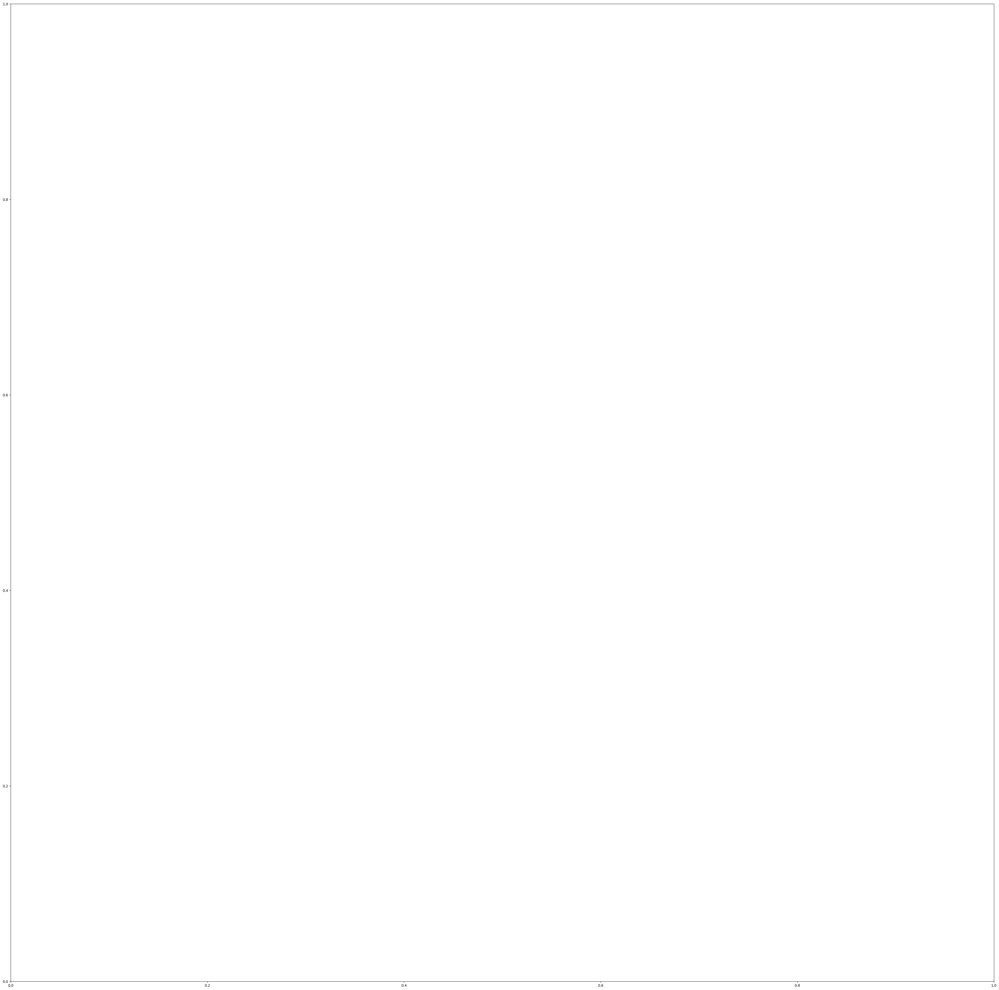

In [170]:
from tkinter import Y
import PIL
import io
import urllib
#fig = plt.figure(figsize=(12,8))
#plt.scatter(reducer.embedding_[:, 0], reducer.embedding_[:, 1], cmap='tab20c')

list_X = []
list_Y = []
for each in embedding:
    list_X.append(each[0])
    list_Y.append(each[1])

print(images[0])
def getImage(path):
   return OffsetImage(plt.imread(path, format="jpg"), zoom=.1)

fig, ax = plt.subplots()

fig.set_size_inches(50, 50)
#For all values
# ax.scatter(list_X, list_Y)
# count = 0
# check = False
# for x0,y0,image in zip(list_X, list_Y, images):
#     if count in random_list or check == True:
#         if(image!=None):
#             try:
#                 response = requests.get(image, verify=False)
#                 image_bytes = io.BytesIO(response.content)
#                 img = PIL.Image.open(image_bytes)
#                 img = img.save("magic_card_{count}.jpeg")
#                 #urllib.urlretrieve(image, "magic_card_{count}.jpeg")
#                 ab = AnnotationBbox(getImage("magic_card_{count}.jpeg"), (x0,y0),frameon = False)
#                 ax.add_artist(ab)
#                 check = False
#             except:
#                 print(image)
#                 check = False
#         else:
#             check = True
#     count = count + 1




In [171]:
#https://www.jcchouinard.com/create-feature-image-with-python-pillow/ for adding text to blank images 
from PIL import Image, ImageDraw, ImageFont

def center_text(img,font,text1,text2,fill1,fill2):
    draw = ImageDraw.Draw(img) # Initialize drawing on the image
    w,h = img.size # get width and height of image
    t1_width, t1_height = draw.textsize(text1, font) # Get text1 size
    t2_width, t2_height = draw.textsize(text2, font) # Get text2 size
    p1 = ((w-t1_width)//7,h // 16) # H-center align text1
    p2 = ((w-t2_width)//7,h // 3 + h // 5) # H-center align text2
    draw.text(p1, text1, fill=fill1, font=font) # draw text on top of image
    draw.text(p2, text2, fill=fill2, font=font) # draw text on top of image
    return img

def add_text(img,color,text1,text2,logo=False,font='Roboto-Bold.ttf',font_size=500):
    draw = ImageDraw.Draw(img)
    p_font = color['p_font']
    s_font = color['s_font']
     
    # starting position of the message
    img_w, img_h = img.size
    height = img_h // 15.5
    font = ImageFont.load_default()
    #font = ImageFont.truetype("/usr/share/fonts/truetype/freefont/FreeMono.ttf", 28, encoding="unic")
 
    if logo == False:
        center_text(img,font,text1,text2,p_font,s_font)
    else:
        text1_offset = (img_w // 10, height)
        text2_offset = (img_w // 10, 5*height)
        draw.text(text1_offset, text1, fill=p_font, font=font)
        draw.text(text2_offset, text2, fill=s_font, font=font)
    return img

In [172]:
def add_logo(background,foreground):
    bg_w, bg_h = background.size
    img_w, img_h = foreground.size
    img_offset = (20, (bg_h - img_h) // 4)
    background.paste(foreground, img_offset, foreground)
    return background

def add_color(image,c,transparency):
    color = Image.new('RGB',image.size,c)
    mask = Image.new('RGBA',image.size,(0,0,0,transparency))
    return Image.composite(image,color,mask).convert('RGB')

def write_image(background,color,text1,text2,foreground=''):
    background = add_color(background,color['c'],25)
    if not foreground:
        add_text(background,color,text1,text2)
    else:
        add_text(background,color,text1,text2,logo=True)
        add_logo(background,foreground)
    return background

[21318, 7377, 15459, 20, 16226, 19984, 10485, 1937, 4023, 10323, 19602, 15750, 19106, 7148, 14823, 120, 2360, 12724, 14085, 3313, 22310, 18361, 5310, 23563, 658, 10779, 12243, 14898, 833, 6360, 19567, 15780, 4667, 17279, 4, 2877, 11418, 13031, 16124, 14105, 16801, 22304, 19208, 5480, 2675, 20132, 10901, 902, 5549, 23407, 3922, 21807, 13613, 15506, 15880, 21692, 9996, 16875, 9975, 19911, 7034, 18455, 11129, 3043, 4286, 6984, 19409, 21743, 5771, 22300, 7499, 20972, 12539, 4859, 20750, 11218, 7817, 14742, 14274, 3310, 9341, 2569, 19258, 13411, 20724, 12372, 1229, 9101, 61, 14688, 1993, 20513, 22809, 18045, 19730, 14427, 22107, 15778, 10659, 4803, 21914, 22721, 1108, 19449, 16280, 18272, 18000, 38, 17427, 9567, 18271, 2341, 14175, 2819, 22052, 22411, 13167, 5638, 19261, 20926, 17460, 20523, 17316, 12020, 4219, 2729, 17948, 13555, 18498, 10267, 12250, 13435, 6387, 13900, 10620, 10749, 17719, 4416, 20317, 18645, 9343, 13111, 15302, 4306, 14860, 22670, 13156, 877, 18505, 11505, 5457, 23604, 1

C:\Users\hunte\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'gatherer.wizards.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(
C:\Users\hunte\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'gatherer.wizards.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(
C:\Users\hunte\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\urllib3\connectionpool.py:1045:

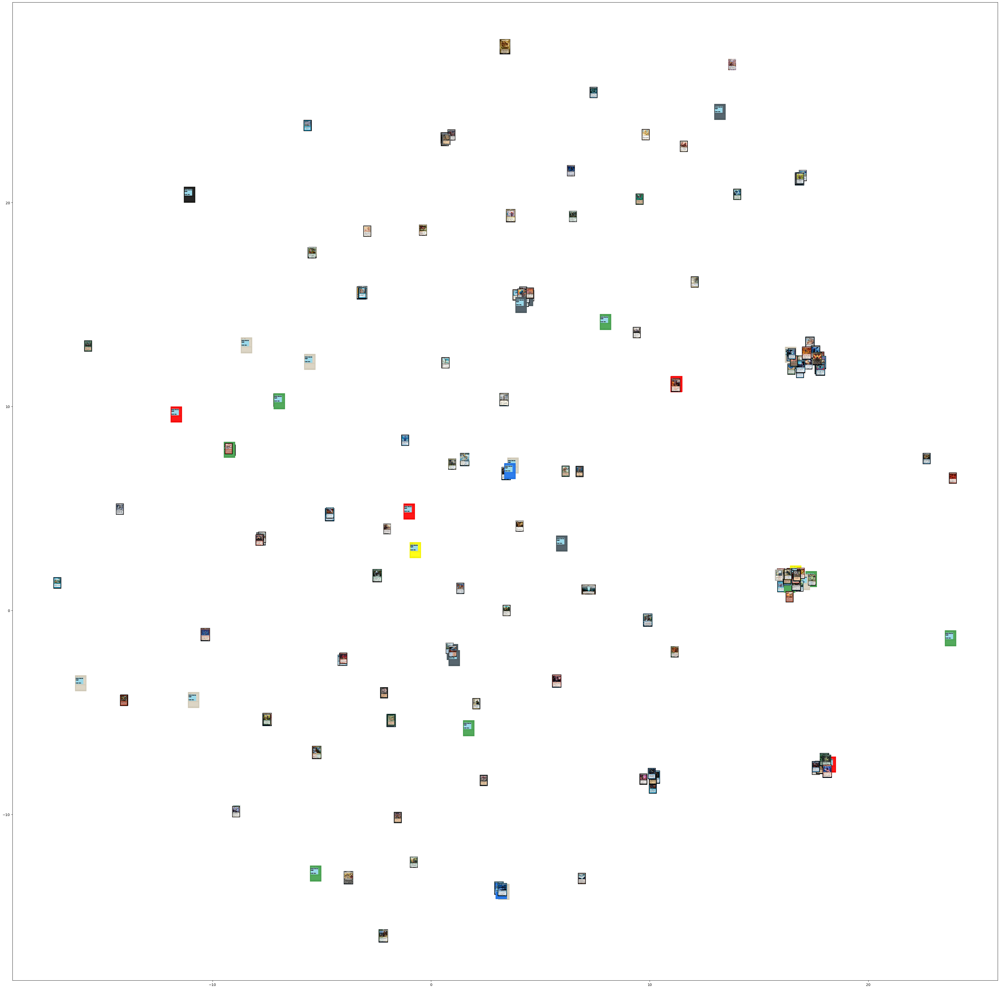

In [173]:
#https://www.jcchouinard.com/create-feature-image-with-python-pillow/ for adding text to blank images 
from msilib.schema import Error


fig, ax = plt.subplots()
fig.set_size_inches(50, 50)

colors = {
    'dark_blue':{'c':(27,53,81),'p_font':'rgb(255,255,255)','s_font':'rgb(255, 212, 55)'},
    'grey':{'c':(70,86,95),'p_font':'rgb(255,255,255)','s_font':'rgb(93,188,210)'},
    'light_blue':{'c':(93,188,210),'p_font':'rgb(27,53,81)','s_font':'rgb(255,255,255)'},
    'blue':{'c':(23,114,237),'p_font':'rgb(255,255,255)','s_font':'rgb(255, 255, 255)'},
    'orange':{'c':(242,174,100),'p_font':'rgb(0,0,0)','s_font':'rgb(0,0,0)'},
    'purple':{'c':(114,88,136),'p_font':'rgb(255,255,255)','s_font':'rgb(255, 212, 55)'},
    'red':{'c':(255,0,0),'p_font':'rgb(0,0,0)','s_font':'rgb(0,0,0)'},
    'yellow':{'c':(255,255,0),'p_font':'rgb(0,0,0)','s_font':'rgb(27,53,81)'},
    'yellow_green':{'c':(232,240,165),'p_font':'rgb(0,0,0)','s_font':'rgb(0,0,0)'},
    'green':{'c':(65, 162, 77),'p_font':'rgb(217, 210, 192)','s_font':'rgb(0, 0, 0)'},
    'black':{'c':(15, 15, 15),'p_font':'rgb(255, 255, 255)','s_font':'rgb(255, 255, 255)'},
    'white':{'c':(217, 210, 192),'p_font':'rgb(0, 0, 0)','s_font':'rgb(0, 0, 0)'}
    }
amount_samples = 200
random_list = sample(range(len(list_X)),amount_samples)
print(random_list)

randomly_picked_X = []
randomly_picked_Y = []
random_images = []
random_annotations = []
random_colors = []
for count, each in enumerate(list_X):
    if(count in random_list):
        randomly_picked_X.append(each)
        randomly_picked_Y.append(list_Y[count])
        random_images.append(images[count])
        random_annotations.append(annotations[count])
        random_colors.append(colors_of_card[count])
        
#For random values
ax.scatter(randomly_picked_X, randomly_picked_Y)
count = 0
check = True
for x0,y0,image in zip(randomly_picked_X, randomly_picked_Y, random_images):
    try:
        response = requests.get(image, verify=False)    
        #print(f'{image} succeeded')
    except (OSError, KeyError) as Error:
        check = False
        #print(f'{image} failed')
    if(check == True):
        image_bytes = io.BytesIO(response.content)
        img = PIL.Image.open(image_bytes).convert("RGB")
        img = img.save("magic_card.jpeg")
    else:
        img_name = "magic_card.jpeg"
        font = 'Roboto-Bold.ttf'
        foreground = Image.open('logo.jpg').convert("RGBA")
        background = Image.open('blank card.jpg')
        background = write_image(background,colors[random_colors[count]],random_annotations[count],random_annotations[count],foreground=foreground)
        background.save(img_name) 
        #urllib.urlretrieve(image, "magic_card_{count}.jpeg")
    check = True
    ab = AnnotationBbox(getImage("magic_card.jpeg"), (x0,y0),frameon = False)
    ax.add_artist(ab)
    count = count + 1
plt.show()
fig.savefig(f'example_working{Which_Search}.svg', format='svg', dpi=1200)


[[  -1 1963]
 [   0   84]
 [   1   74]
 [   2   74]
 [   3   71]
 [   4  228]
 [   5  117]
 [   6  435]
 [   7   50]
 [   8   74]
 [   9   60]
 [  10  154]
 [  11   92]
 [  12  154]
 [  13  396]
 [  14  384]
 [  15  140]
 [  16   62]
 [  17 1107]
 [  18   52]
 [  19 2682]
 [  20  188]
 [  21   85]
 [  22   71]
 [  23  139]
 [  24   52]
 [  25  107]
 [  26   75]
 [  27   50]
 [  28   74]
 [  29   78]
 [  30  435]
 [  31  358]
 [  32  134]
 [  33  126]
 [  34  129]
 [  35 1481]
 [  36   50]
 [  37  264]
 [  38  126]
 [  39   86]
 [  40   50]
 [  41   70]
 [  42   65]
 [  43  182]
 [  44  103]
 [  45   51]
 [  46 2794]
 [  47   73]
 [  48 1038]
 [  49  133]
 [  50   71]
 [  51  391]
 [  52  372]
 [  53   97]
 [  54  119]
 [  55  100]
 [  56  139]
 [  57   82]
 [  58   86]
 [  59   72]
 [  60  191]
 [  61   50]
 [  62  192]
 [  63  236]
 [  64   71]
 [  65   71]
 [  66  708]
 [  67   58]
 [  68  149]
 [  69   69]
 [  70   88]
 [  71   97]
 [  72  129]
 [  73  268]
 [  74   69]
 [  75  222]

<Figure size 640x480 with 0 Axes>

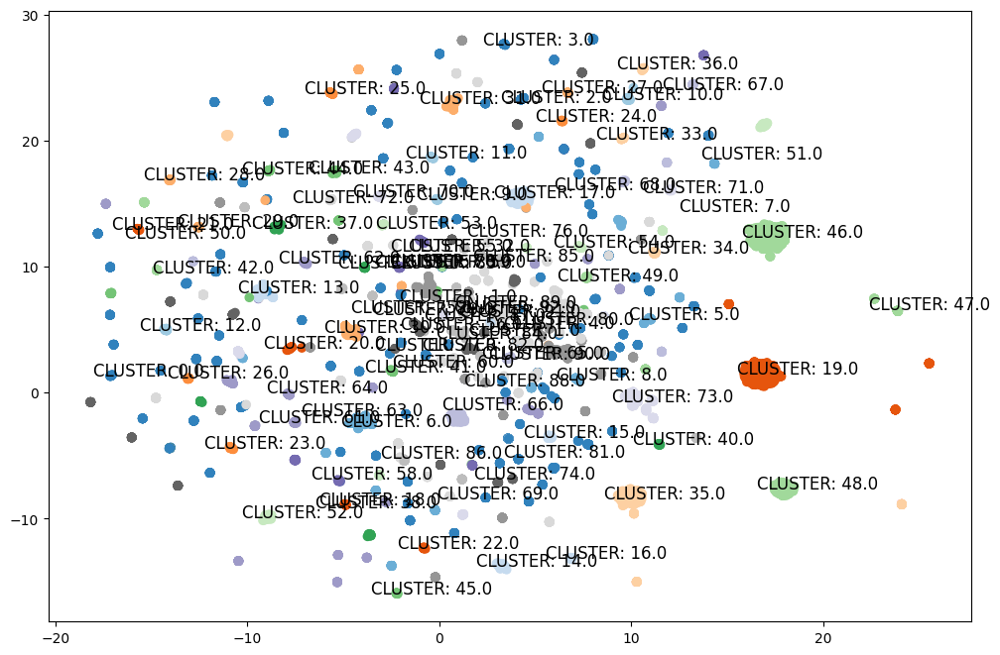

In [174]:
plt.clf()
# this is the data that we need to cluster
labels = hdbscan.HDBSCAN(
    min_samples=10,
    min_cluster_size=50
).fit_predict(X_reduced)

unique, counts = np.unique(labels, return_counts=True)
print (np.asarray((unique, counts)).T)

fig = plt.figure(figsize=(12,8))
plt.scatter(reducer.embedding_[:, 0], reducer.embedding_[:, 1], c=labels, cmap='tab20c')

viz_clusters = pd.DataFrame(embedding)
viz_clusters['cluster'] = labels

for row in viz_clusters.groupby('cluster').mean().reset_index().values:
    label = f'CLUSTER: {row[0]}'
    plt.annotate(label, (row[1], row[2]), textcoords="offset points", fontsize=12,  xytext=(25,0), ha='center') 
plt.show()

In [175]:
# #Hyperparameters
# input_size = 784
# num_classes = 10
# learning_rate = 0.001
# batch_size = 64
# num_epochs = 1

# #Create Fully Connected Network
# class NN(nn.Module):
#     def __init__(self,input_size, num_classes): # (28x28 images)
#         super(NN, self).__init__()
#         self.fc1 = nn.Linear(input_size, 50)
#         self.fc2 = nn.Linear(50, num_classes)
        
#     def forward(self, x):
#         x = F.relu(self.fc1(x))
#         x = self.fc2(x)
#         return x
    
# model = NN(input_size,num_classes)

# x = torch.randn(batch_size,input_size)

# print(model(x).shape)

In [176]:
# #Set device
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(device)

In [177]:
# #Load Data
# train_dataset = datasets.MNIST(root = 'dataset/', train = True, transform = transforms.ToTensor(), download = True)
# print(train_dataset)
# train_loader = DataLoader(dataset = train_dataset, batch_size = batch_size, shuffle = True)
# test_dataset = datasets.MNIST(root = 'dataset/', train = False, transform = transforms.ToTensor(), download = True)
# test_loader = DataLoader(dataset = train_dataset, batch_size = batch_size, shuffle = True)

In [178]:
# # Initialize Network
# model = NN(input_size = input_size, num_classes = num_classes).to(device)


In [179]:
# #Loss and optimizer
# criterion = nn.CrossEntropyLoss()
# optimizer = optim.Adam(model.parameters(), lr = learning_rate)

In [180]:
# #Train Network
# for epoch in range(num_epochs):
#     for batch_idx, (data, targets) in enumerate(train_loader):
#         #Get Data to cuda if possible
#         data = data.to(device=device)
#         targets = targets.to(device=device)
#         #Change lots of data into one long vector
#         data = data.reshape(data.shape[0], -1)
#         #forward
#         scores = model(data)
#         loss = criterion(scores, targets)
#         #backward
#         optimizer.zero_grad()
#         loss.backward()
#         #gradient descent or adam step, update weights based on gradients computed
#         optimizer.step()

In [181]:
# #check accuracy of model

# def check_accuracy(loader,model):
#     if loader.dataset.train:
#         print("Checking accuracy on training data")
#     else:
#         print("Checking accuracy on test data")
#     num_correct = 0
#     num_samples = 0
#     model.eval()
    
#     with torch.no_grad():
#         for x,y in loader:
#             x = x.to(device=device)
#             y = y.to(device=device)
#             x = x.reshape(x.shape[0], -1)
            
#             scores = model(x)
#             #64x10, 0
#             scores.max()
#             _, predictions = scores.max(1)
#             num_correct += (predictions == y).sum()
#             num_samples += predictions.size(0)
#         print(f'Got {num_correct} / {num_samples} with accuracy {float(num_correct)/float(num_samples)*100:.2f}')

#     model.train()



In [182]:
# check_accuracy(train_loader, model)
# check_accuracy(test_loader, model)